In [3]:
import sys
import subprocess

#import pkg_resources
#required = {'harmonypy','sklearn','scanpy','pandas', 'numpy', 'bbknn', 'scipy', 'matplotlib', 'seaborn' ,'scipy'}
#installed = {pkg.key for pkg in pkg_resources.working_set}
#missing = required - installed
#if missing:
#    print("Installing missing packages:" )
#    print(missing)
#    python = sys.executable
#    subprocess.check_call([python, '-m', 'pip', 'install', *missing], stdout=subprocess.DEVNULL)

%matplotlib inline
from collections import Counter
from collections import defaultdict
import scanpy as sc
import pandas as pd
import pickle as pkl
import numpy as np
from bbknn import bbknn
import scipy
import matplotlib.pyplot as plt
import re
import glob
import os
import sys
from geosketch import gs
from numpy import cov
import scipy.cluster.hierarchy as spc
import seaborn as sns; sns.set(color_codes=True)
from sklearn.linear_model import LogisticRegression
import sklearn
import harmonypy as hm
from pathlib import Path

In [2]:
sc.settings.set_figure_params(dpi=300, color_map='viridis')
plt.rcParams['figure.figsize'] = [5, 5]

In [5]:
adata_pre_mono = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/YS_fliv_gastrula_monocytes/ys_fliv_gastrula_monocytes/mono_traj_below_cs14.h5ad')

In [6]:
adata_pre_mono.obs['cell.labels'].unique()

['MEMP', 'HSPC_1', 'Macrophage', 'HSPC_2', 'MOP', 'CMP', 'Pre_Macrophage']
Categories (7, object): ['CMP', 'HSPC_1', 'HSPC_2', 'MEMP', 'MOP', 'Macrophage', 'Pre_Macrophage']

In [7]:
adata_pre_mono = adata_pre_mono[adata_pre_mono.obs['cell.labels'].isin([ 'HSPC_1', 'Macrophage', 'HSPC_2', 'MOP', 'CMP', 'Pre_Macrophage'])]

In [8]:
sc.pp.neighbors(adata_pre_mono  ,n_neighbors=30, n_pcs=5)
sc.tl.umap(adata_pre_mono )
sc.tl.draw_graph(adata_pre_mono , layout='fa')

In [9]:
sc.tl.leiden(adata_pre_mono)

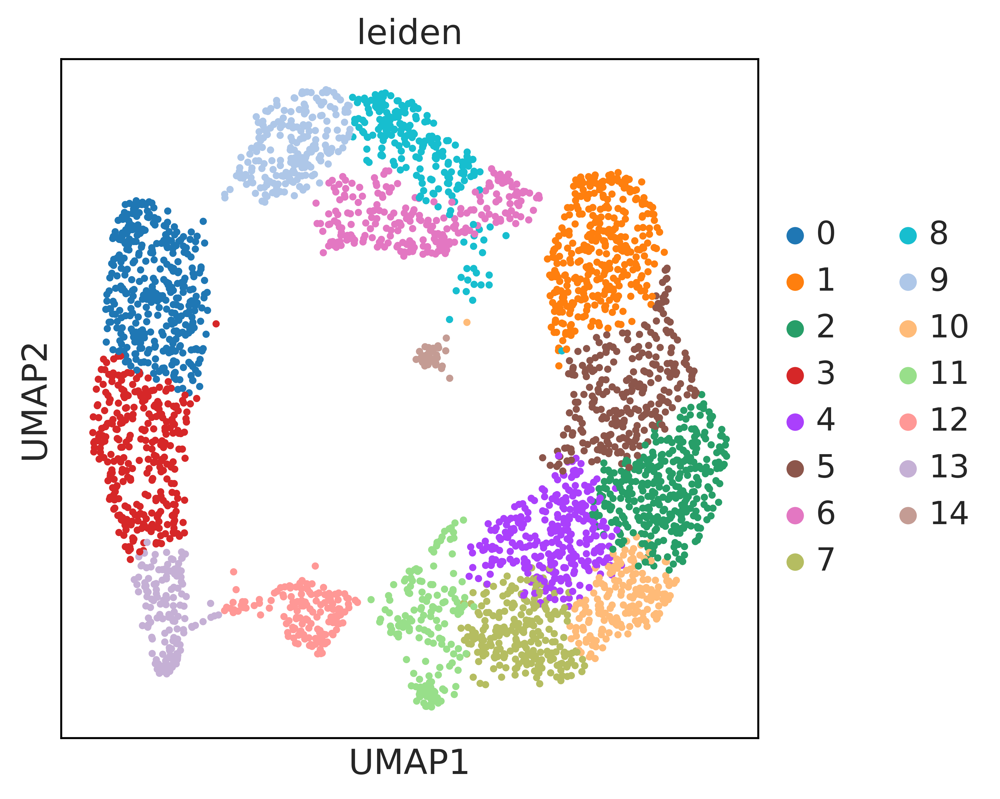

In [10]:
sc.pl.umap(adata_pre_mono,color = 'leiden')

In [11]:
adata_pre_mono = adata_pre_mono[~adata_pre_mono.obs['leiden'].isin(['12'])]

Trying to set attribute `.uns` of view, copying.


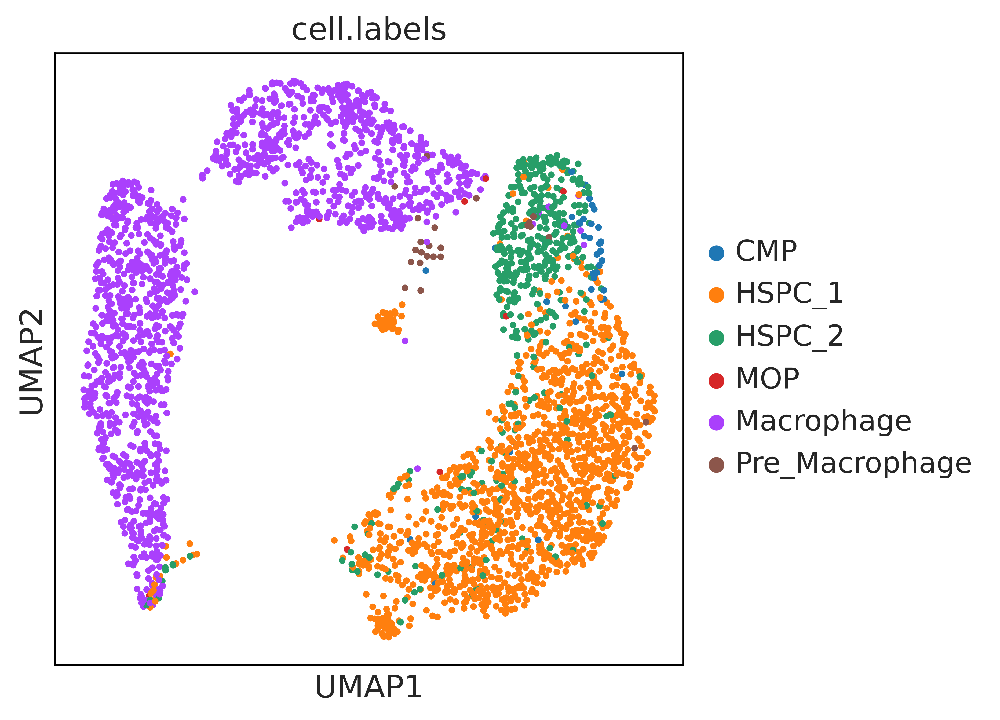

In [12]:
sc.pl.umap(adata_pre_mono,color = 'cell.labels')

In [18]:
adata_pre_mono.uns['cell.labels_colors']

array(['#ffff00', '#1ce6ff', '#ff34ff', '#ff4a46', '#008941', '#006fa6',
       '#a30059', '#ffdbe5', '#7a4900', '#0000a6', '#63ffac', '#b79762',
       '#004d43', '#8fb0ff', '#997d87', '#5a0007', '#809693', '#6a3a4c',
       '#1b4400', '#4fc601', '#3b5dff', '#4a3b53', '#ff2f80', '#61615a',
       '#ba0900', '#6b7900', '#00c2a0', '#ffaa92', '#ff90c9', '#b903aa',
       '#d16100', '#ddefff', '#000035', '#7b4f4b', '#a1c299', '#300018',
       '#0aa6d8', '#013349', '#00846f', '#372101', '#ffb500', '#c2ffed',
       '#a079bf', '#cc0744', '#c0b9b2', '#c2ff99', '#001e09', '#00489c',
       '#6f0062'], dtype=object)

In [27]:
adata_pre_mono.obs['cell.labels'].cat.categories

Index(['CMP', 'HSPC_1', 'HSPC_2', 'MOP', 'Macrophage', 'Pre_Macrophage'], dtype='object')

In [28]:
adata_pre_mono.obs['cell.labels'] = adata_pre_mono.obs['cell.labels'].astype('category')

In [367]:
'CMP', 'HSPC_1', 'HSPC_2', 'MOP', 'Macrophage', 'Pre_Macrophage'

('CMP', 'HSPC_1', 'HSPC_2', 'MOP', 'Macrophage', 'Pre_Macrophage')

In [368]:
colors = {'CMP': '#1f77b4',
 'HSPC_1': '#ff7f0e',
 'HSPC_2': '#279e68',
 'MOP': '#d62728',
 'Macrophage': '#aa40fc',
 'Microglia': '#8c564b',
 'Monocyte': '#e377c2',
 'Monocyte_Macrophage': '#b5bd61',
 'Pre_Macrophage': '#17becf',
 'Promonocyte': '#aec7e8'}
list(adata_post_mono.obs['cell.labels'].cat.categories)


['CMP',
 'HSPC_1',
 'HSPC_2',
 'MEMP',
 'MOP',
 'Macrophage',
 'Microglia',
 'Monocyte',
 'Monocyte_Macrophage',
 'Pre_Macrophage',
 'Promonocyte']

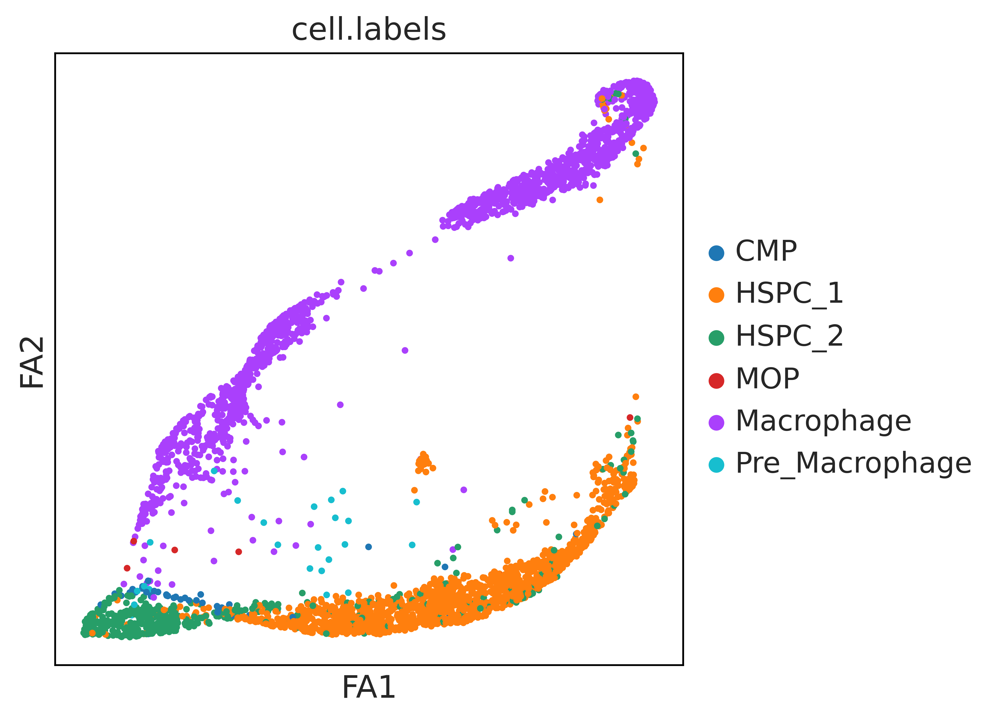

In [43]:
sc.pl.draw_graph(adata_pre_mono,color = 'cell.labels',palette = colors)

In [102]:
sc.tl.paga(adata_pre_mono, groups='cell.labels', use_rna_velocity=False, model='v1.2', neighbors_key=None, copy=False)

In [103]:
sc.tl.draw_graph(adata_pre_mono, init_pos='paga')

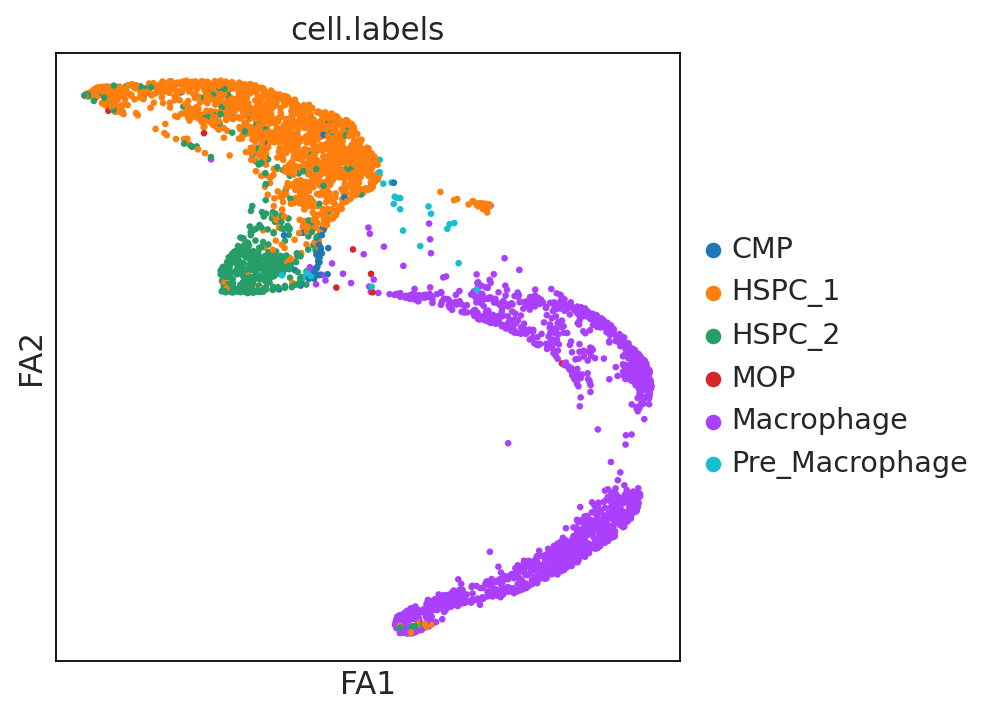

In [104]:
sc.pl.draw_graph(adata_pre_mono,color = 'cell.labels',palette = colors, edges=False, edges_width=0.1)

In [105]:
sc.set_figure_params( transparent=True,)
plt.rcParams['figure.figsize'] = [5, 5]

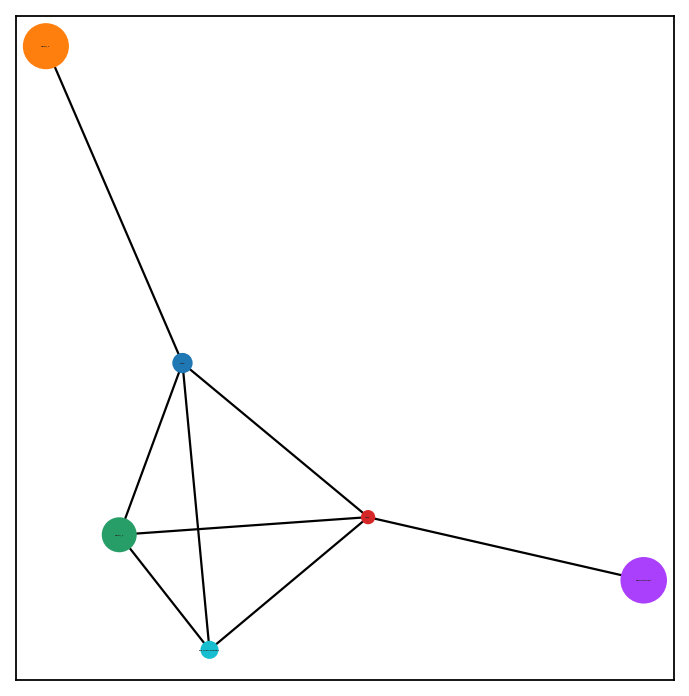

In [128]:
sc.pl.paga(adata_pre_mono, threshold=0.6, color = 'cell.labels' , root=0, solid_edges='connectivities',max_edge_width=1, edge_width_scale=0.5,fontsize = 0,save='paga_pre-mono')

In [ ]:
import inspect
source_code = inspect.getsource(sc.pl.paga_compare)  # foo is normal function
print(source_code)

In [ ]:
sc.pl.paga_compare(adata_pre_mono, threshold=0.4 , title='', right_margin=0.2, size=10, edge_width_scale=0.2,legend_fontsize=12, fontsize=12, frameon=False, edges=False, save=True)

In [245]:
cells = adata.obs['cell.labels'].cat.categories
embed = 'X_draw_graph_fa'
pos = []
for i in cells:
    tmp = adata[adata.obs['cell.labels'].isin([i])]
    tmp_emded = tmp.obsm[embed]
    # get centroids
    x = [p[0] for p in tmp_emded]
    y = [p[1] for p in tmp_emded]
    centroid = (sum(x) / len(tmp_emded), sum(y) / len(tmp_emded))
    pos.append(centroid)
    
adata_pre_mono.uns['paga-back'] = adata_pre_mono.uns['paga'].copy()
adata_pre_mono.uns['paga']['pos']= np.array(pos)

In [274]:
adata.uns

{'corr_concat_colors': array(['#1f77b4', '#ff7f0e', '#279e68', '#aa40fc', '#8c564b', '#e377c2'],
       dtype=object),
 'diffmap_evals': array([1.        , 1.        , 0.9966048 , 0.99443   , 0.9887729 ,
        0.97155213, 0.9675878 , 0.9508513 , 0.94257134, 0.9233616 ,
        0.91266835, 0.899351  , 0.89773595, 0.8971941 , 0.88420224],
       dtype=float32),
 'draw_graph': {'params': {'layout': 'fa', 'random_state': 0}},
 'hvg': {'flavor': 'seurat'},
 'lr_batch_colors': array(['#1f77b4', '#ff7f0e'], dtype=object),
 'neighbors': OverloadedDict, wrapping:
 	{'connectivities_key': 'connectivities', 'distances_key': 'distances', 'params': {'n_neighbors': 30, 'method': 'umap', 'random_state': 0, 'metric': 'euclidean', 'n_pcs': 5}}
 With overloaded keys:
 	['connectivities', 'distances'].,
 'pca': {'params': {'use_highly_variable': True, 'zero_center': True},
  'variance': array([166.2008   ,  38.75289  ,  21.297493 ,  11.575994 ,   7.8683505,
           7.6887875,   7.3747387,   6.367692

In [306]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=150, frameon=True, vector_friendly=True, fontsize=14, figsize=None, color_map=None, format='pdf', facecolor=None, transparent= True)

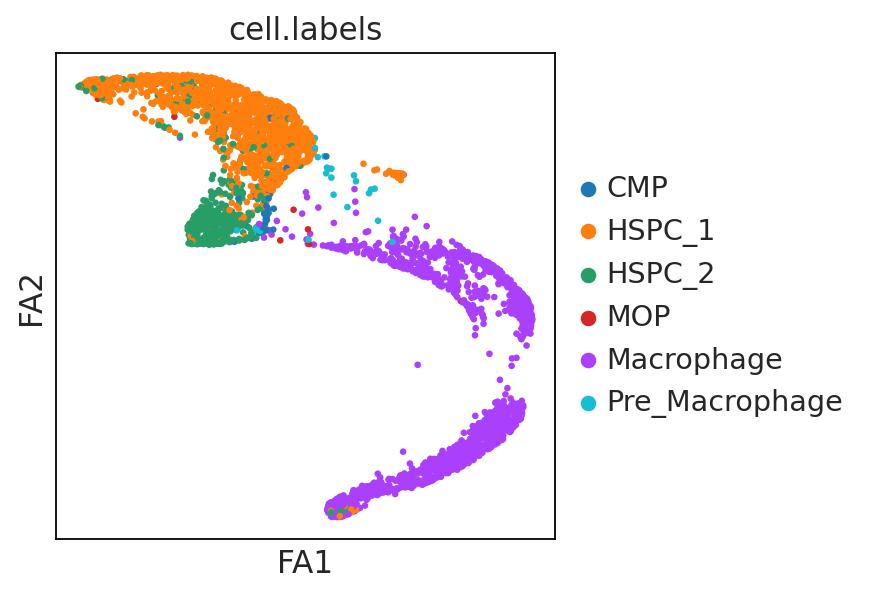

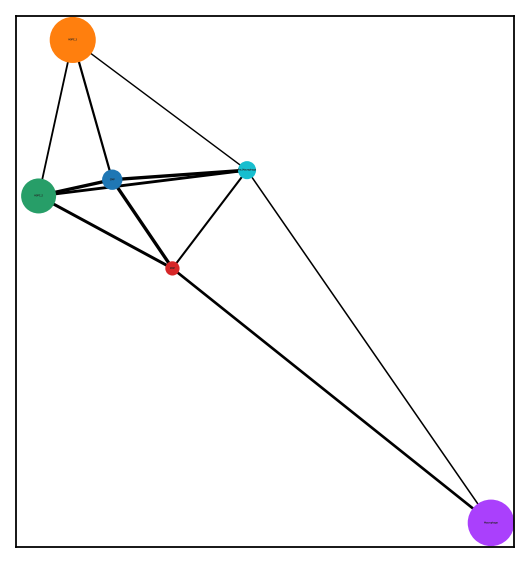

In [316]:
sc.pl.draw_graph(adata_pre_mono,color = 'cell.labels',palette = colors, edges=False, edges_width=0.1)
sc.pl.paga(adata_pre_mono, threshold=0.4 , title='',edge_width_scale=0.2 ,pos =adata_pre_mono.uns['paga']['pos'],fontsize=0 ,fontoutline=0 , fontweight=0,)

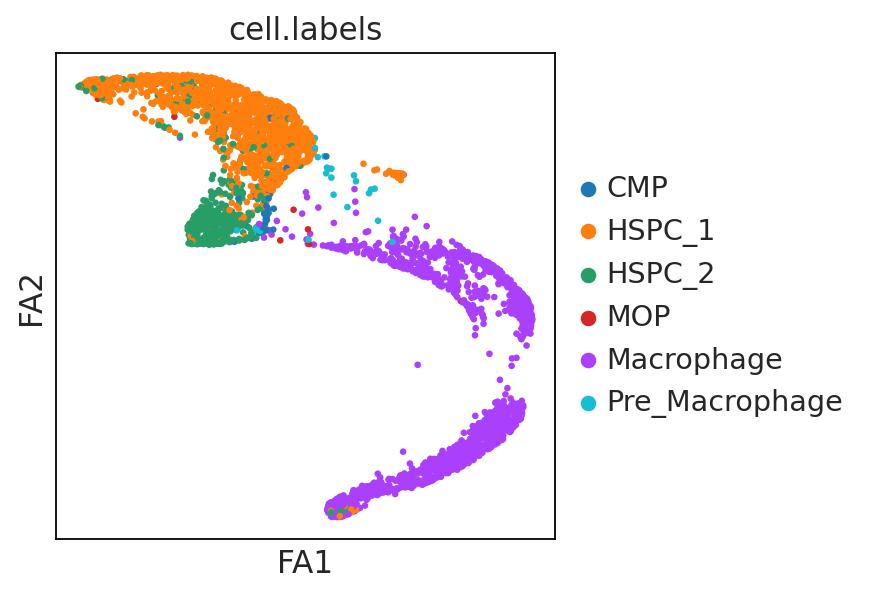

In [312]:
fig, ax = plt.subplots()
#fig, ax = plt.subplots(1,figsize=(12,8))
p3 = sc.pl.draw_graph(adata_pre_mono,color = 'cell.labels',palette = colors, edges=False, edges_width=0.1,ax=ax)
p2 = sc.pl.paga(adata_pre_mono, threshold=0.4 , title='',edge_width_scale=0.2 ,pos =adata_pre_mono.uns['paga']['pos'],fontsize=0 ,fontoutline=0 , fontweight=0,ax=ax)

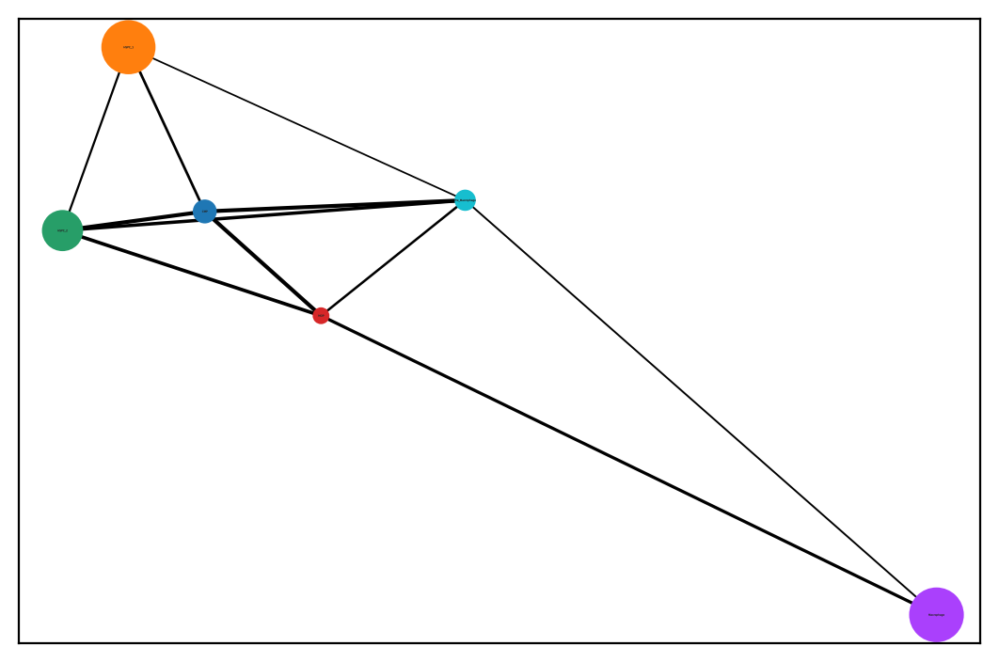

In [272]:
ax1 = sc.pl.paga(adata_pre_mono, threshold=0.4 , title='',edge_width_scale=0.2 ,pos =adata_pre_mono.uns['paga']['pos'],fontsize=0 ,fontoutline=0 , fontweight=0)

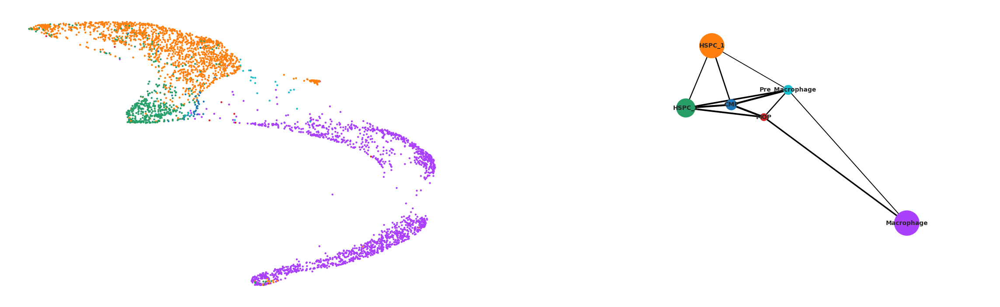

In [214]:
sc.pl.paga_compare(adata_pre_mono, threshold=0.4 , title='', right_margin=0.2, size=10, edge_width_scale=0.2,
    legend_fontsize=5, fontsize=8, frameon=False, edges=False, save=True,legend_loc='right',)

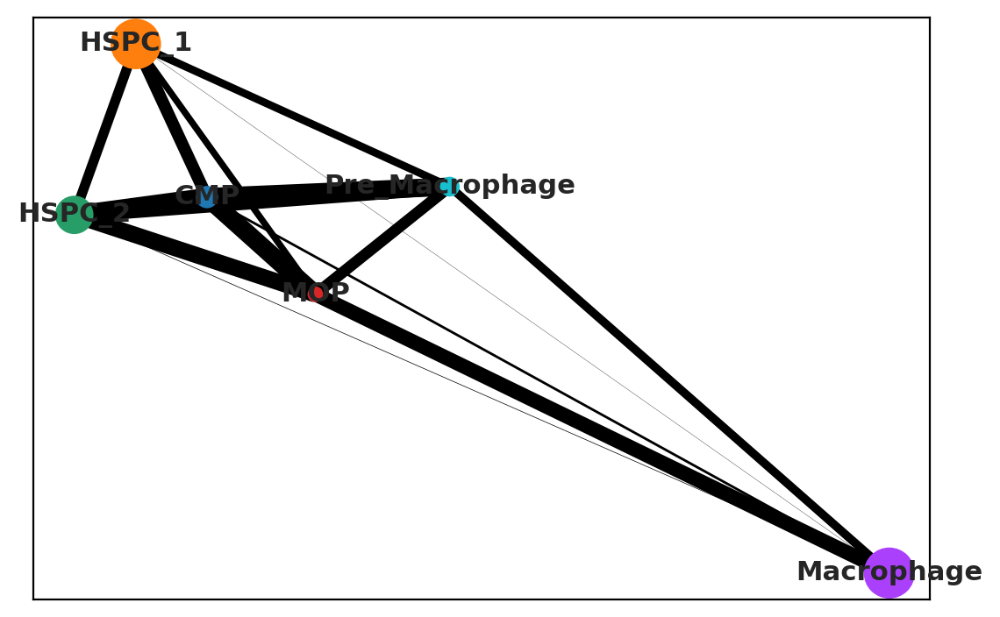

In [266]:
sc.pl.paga(
        adata,
        show=False,
        save=False,
        pos=np.array(pos),
    )

In [47]:
adata_pre_mono.write('adata_pre_mono.h5ad')

In [16]:
adata_pre_mono.uns['cell.labels_colors'] = adata_post_mono.uns['cell.labels_colors']

In [73]:
sc.tl.paga(adata_post_mono, groups='cell.labels', use_rna_velocity=False, model='v1.2', neighbors_key=None, copy=False)

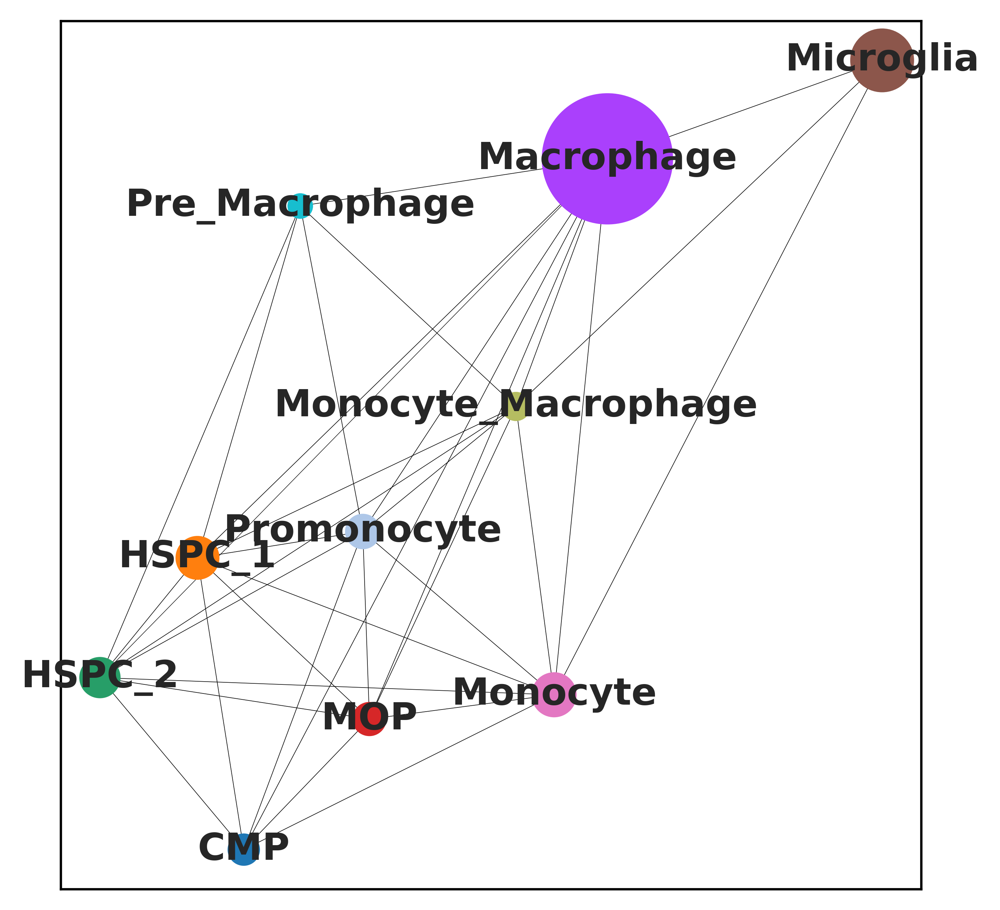

In [74]:
sc.pl.paga(adata_post_mono, threshold=None, color = 'cell.labels' , root=0, solid_edges='connectivities',max_edge_width=0.2)

In [4]:
adata_post_mono = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig3_Macrophages/mono_traj_YS_fliv_gastrula_monocytes/ys_fliv_gastrula_monocytes/100222_post_mono.h5ad')

In [24]:
dict(zip(list(adata_post_mono.obs['cell.labels'].cat.categories),list(adata_post_mono.uns['cell.labels_colors'])))

{'CMP': '#1f77b4ff',
 'HSPC_1': '#ff7f0eff',
 'HSPC_2': '#279e68ff',
 'MOP': '#d62728ff',
 'Macrophage': '#aa40fcff',
 'Microglia': '#8c564bff',
 'Monocyte': '#e377c2ff',
 'Monocyte_Macrophage': '#b5bd61ff',
 'Pre_Macrophage': '#17becfff',
 'Promonocyte': '#aec7e8ff'}

In [25]:
adata_post_mono

AnnData object with n_obs × n_vars = 35934 × 16849
    obs: 'cell.labels', 'stage', 'lanes', 'sex', 'sort.ids', 'fetal.ids', 'component', 'broad_cell.labels', 'sequencing.type', 'orig.dataset', 'broad_cell_labels_organ', 'tissue', 'corr_concat', 'lr_batch', 'keep'
    var: 'n_cells-0', 'mt-0', 'total_counts-0', 'highly_variable-0', 'intersect-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'gene.mean-1', 'gene.dispersion-1', 'gene.dispersion.scaled-1', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cell.labels_colors', 'cell.labels_sizes', 'corr_concat_colors', 'draw_graph', 'hvg', 'lr_batch_colors', 'neighbors', 'paga', 'paga-back', 'pca', 'umap'
    obsm: 'X_draw_graph_fa', 'X_pca', 'X_pca_back', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [26]:
adata_post_mono = adata_post_mono[~adata_post_mono.obs['cell.labels'].isin(['MEMP'])]

In [27]:
adata_post_mono.uns

{'cell.labels_colors': array(['#1f77b4ff', '#ff7f0eff', '#279e68ff', '#d62728ff', '#aa40fcff',
        '#8c564bff', '#e377c2ff', '#b5bd61ff', '#17becfff', '#aec7e8ff'],
       dtype=object),
 'cell.labels_sizes': array([   91,   341,   263,   116, 32874,  1668,   383,    58,    32,
          136]),
 'corr_concat_colors': array(['#1f77b4', '#ff7f0e', '#279e68', '#aa40fc', '#8c564b', '#e377c2',
        '#b5bd61', '#17becf', '#aec7e8', '#ffbb78'], dtype=object),
 'draw_graph': {'params': {'layout': 'fa', 'random_state': 0}},
 'hvg': {'flavor': 'seurat'},
 'lr_batch_colors': array(['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b'],
       dtype=object),
 'neighbors': OverloadedDict, wrapping:
 	{'connectivities_key': 'connectivities', 'distances_key': 'distances', 'params': {'method': 'umap', 'metric': 'euclidean', 'n_neighbors': 15, 'n_pcs': 50, 'random_state': 0}}
 With overloaded keys:
 	['connectivities', 'distances'].,
 'paga': {'connectivities': <10x10 sparse matrix o

In [28]:
list(adata_post_mono.obs['cell.labels'].cat.categories)

['CMP',
 'HSPC_1',
 'HSPC_2',
 'MOP',
 'Macrophage',
 'Microglia',
 'Monocyte',
 'Monocyte_Macrophage',
 'Pre_Macrophage',
 'Promonocyte']

In [29]:
##Subsample by frac
data2= adata_post_mono.obs[:]
grouped = data2.groupby('cell.labels')
df = grouped.apply(lambda x: x.sample(frac=0.1))
df = df.droplevel('cell.labels')
keep = df.index

remove = adata_post_mono.obs.index[adata_post_mono.obs['cell.labels'].isin(['Macrophage']) & ~(adata_post_mono.obs.index.isin(keep))]
adata_post_mono = adata_post_mono[~adata_post_mono.obs.index.isin(remove)]

In [30]:
adata_post_mono

View of AnnData object with n_obs × n_vars = 6356 × 16849
    obs: 'cell.labels', 'stage', 'lanes', 'sex', 'sort.ids', 'fetal.ids', 'component', 'broad_cell.labels', 'sequencing.type', 'orig.dataset', 'broad_cell_labels_organ', 'tissue', 'corr_concat', 'lr_batch', 'keep'
    var: 'n_cells-0', 'mt-0', 'total_counts-0', 'highly_variable-0', 'intersect-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'gene.mean-1', 'gene.dispersion-1', 'gene.dispersion.scaled-1', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cell.labels_colors', 'cell.labels_sizes', 'corr_concat_colors', 'draw_graph', 'hvg', 'lr_batch_colors', 'neighbors', 'paga', 'paga-back', 'pca', 'umap'
    obsm: 'X_draw_graph_fa', 'X_pca', 'X_pca_back', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

2022-02-14 09:17:52,972 - harmonypy - INFO - Iteration 1 of 10
INFO:harmonypy:Iteration 1 of 10
2022-02-14 09:17:56,688 - harmonypy - INFO - Iteration 2 of 10
INFO:harmonypy:Iteration 2 of 10
2022-02-14 09:17:59,670 - harmonypy - INFO - Converged after 2 iterations
INFO:harmonypy:Converged after 2 iterations


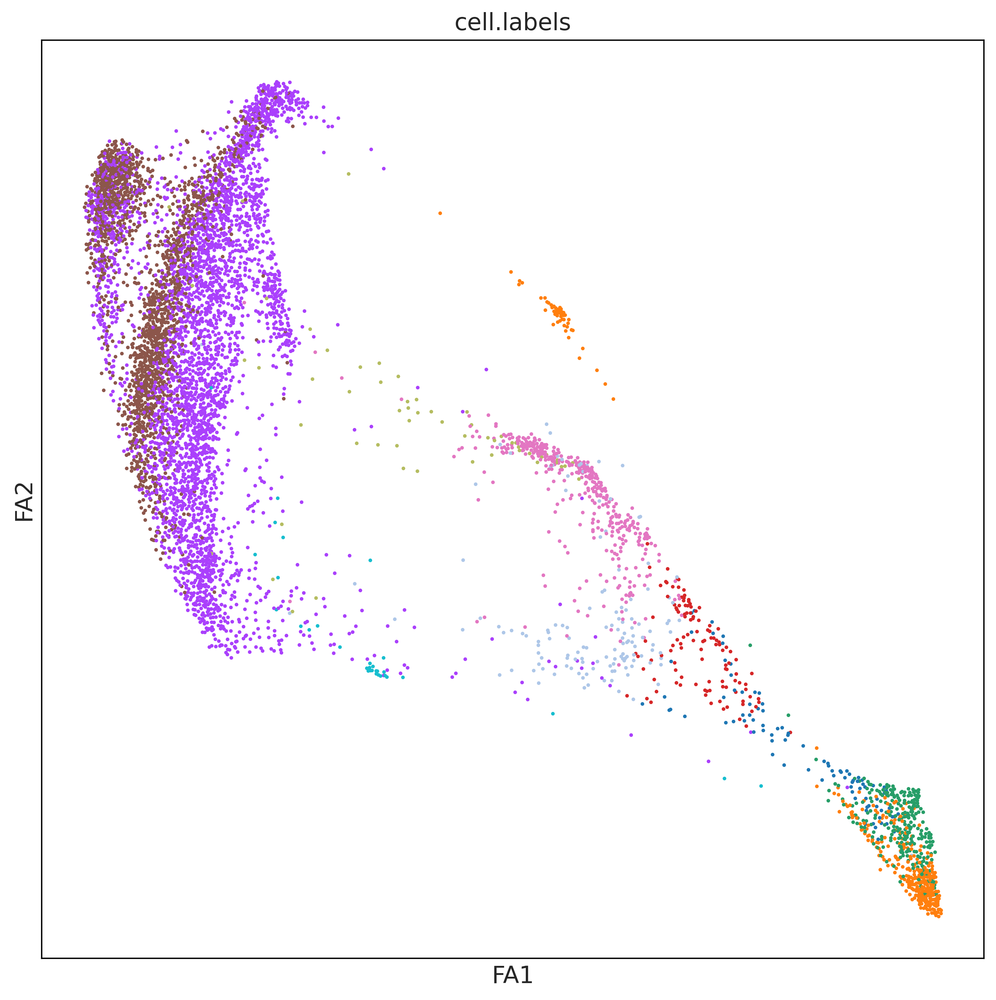

In [31]:
# Now compute PCA
sc.pp.pca(adata_post_mono, n_comps=50, use_highly_variable=True, svd_solver='arpack')


# Set harmony variables
data_mat = np.array(adata_post_mono.obsm["X_pca"])
meta_data = adata_post_mono.obs
vars_use = ['lr_batch']
# Run Harmony
ho = hm.run_harmony(data_mat, meta_data, vars_use)
res = (pd.DataFrame(ho.Z_corr)).T
res.columns = ['X{}'.format(i + 1) for i in range(res.shape[1])]
# Insert coordinates back into object
adata_post_mono.obsm["X_pca_back"]= adata_post_mono.obsm["X_pca"][:]
adata_post_mono.obsm["X_pca"] = np.array(res)
# Run neighbours
sc.pp.neighbors(adata_post_mono, n_neighbors=15, n_pcs=50)

sc.tl.paga(adata_post_mono, groups='cell.labels', use_rna_velocity=False, model='v1.2', neighbors_key=None, copy=False)
# sc.tl.draw_graph(adata_post_mono , layout='fa',init_pos = 'paga')
sc.tl.draw_graph(adata_post_mono , layout='fa')
sc.pl.draw_graph(adata_post_mono,color = 'cell.labels',legend_loc=None)

In [32]:
# ALG to tighten the FDG

# cells = adata.obs['cell.labels'].cat.categories
# embed = 'X_draw_graph_fa'
# pos = []
# for i in cells:
#     tmp = adata[adata.obs['cell.labels'].isin([i])]
#     tmp_emded = tmp.obsm[embed]
#     # get centroids
#     x = [p[0] for p in tmp_emded]
#     y = [p[1] for p in tmp_emded]
#     centroid = (sum(x) / len(tmp_emded), sum(y) / len(tmp_emded))
#     pos.append(centroid)
    
# adata_post_mono.uns['paga-back'] = adata_post_mono.uns['paga'].copy()
# adata_post_mono.uns['paga']['pos']= np.array(pos)


# Estimate cluster centroid position by density
sc.tl.embedding_density(adata, groupby='cell.labels')
pos = []
map_scores = []
for i in adata.obs['cell.labels'].cat.categories:
    # make bg blue
    adata.obs['umap_density_dataset_annot_'+i] = adata.obs['umap_density_cell.labels']
    adata.obs.loc[~adata.obs['cell.labels'].isin([i]),('umap_density_dataset_annot_'+i)] = 0.1
    #sc.pl.umap(adata,color = ('umap_density_dataset_annot_'+i),color_map = 'turbo')
    
    map_scores.append('umap_density_dataset_annot_'+i)
    tmp_fa= adata.obsm['X_draw_graph_fa'][adata.obs['umap_density_dataset_annot_'+i] == np.max(adata.obs['umap_density_dataset_annot_'+i])]
    centroid = (np.median([p[0] for p in tmp_fa]), np.median([p[1] for p in tmp_fa]))
    pos.append(centroid)
    
adata.uns['paga-back'] = adata.uns['paga'].copy()
adata.uns['paga']['pos']= np.array(pos)
    
#sc.pl.umap(adata,color = 'umap_density_dataset_annot',color_map = 'turbo')
#sc.pl.embedding_density(adata, groupby='dataset_annot',color_map = 'seismic')
sc.pl.draw_graph(adata,color = map_scores,color_map = 'turbo',legend_loc=None)

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'col' as categorical


In [33]:
# Convergence alg
tmp_fa= adata.obsm['X_draw_graph_fa'][adata.obs['umap_density_dataset_annot_'+i] == np.max(adata.obs['umap_density_dataset_annot_'+i])]

In [34]:
tmp_fa

array([[-57275.33616349,  -9641.61862615]])

In [35]:
#sc.tl.draw_graph(adata_post_mono, init_pos='paga')

In [36]:
sc.set_figure_params( transparent=True,)
plt.rcParams['figure.figsize'] = [5, 5]

In [37]:
adata = adata_post_mono[:]

Trying to set attribute `.obs` of view, copying.


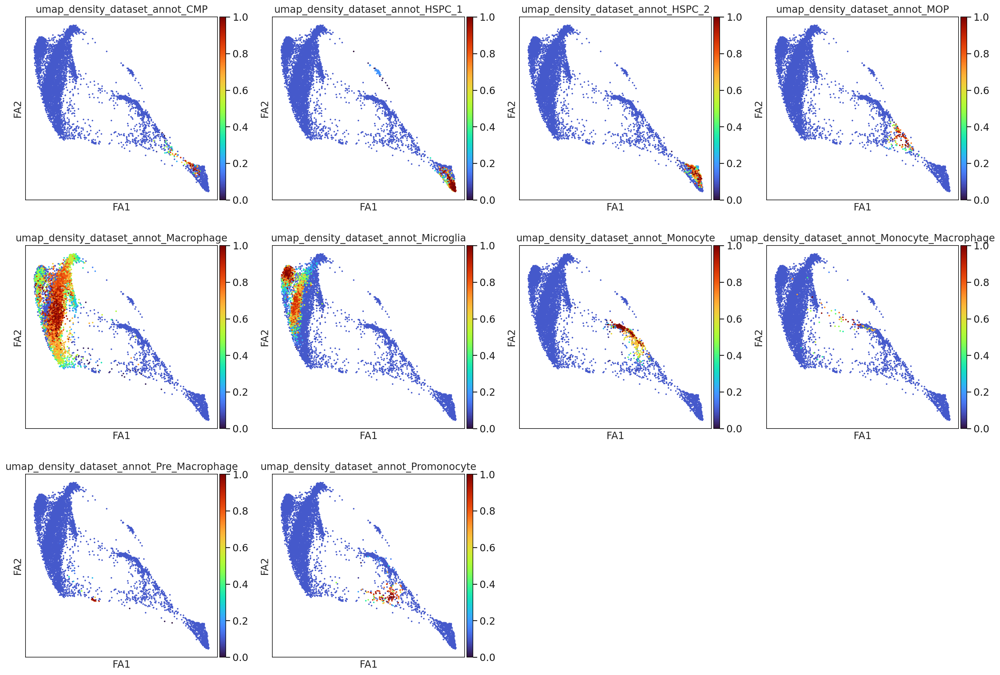

In [38]:
# cells = adata.obs['cell.labels'].cat.categories
# embed = 'X_draw_graph_fa'
# pos = []
# for i in cells:
#     tmp = adata[adata.obs['cell.labels'].isin([i])]
#     tmp_emded = tmp.obsm[embed]
#     # get centroids
#     x = [p[0] for p in tmp_emded]
#     y = [p[1] for p in tmp_emded]
#     centroid = (sum(x) / len(tmp_emded), sum(y) / len(tmp_emded))
#     pos.append(centroid)
    
# adata_post_mono.uns['paga-back'] = adata_post_mono.uns['paga'].copy()
# adata_post_mono.uns['paga']['pos']= np.array(pos)


# Estimate cluster centroid position by density
sc.tl.embedding_density(adata, groupby='cell.labels')
pos = []
map_scores = []
for i in adata.obs['cell.labels'].cat.categories:
    # make bg blue
    adata.obs['umap_density_dataset_annot_'+i] = adata.obs['umap_density_cell.labels']
    adata.obs.loc[~adata.obs['cell.labels'].isin([i]),('umap_density_dataset_annot_'+i)] = 0.1
    #sc.pl.umap(adata,color = ('umap_density_dataset_annot_'+i),color_map = 'turbo')
    
    map_scores.append('umap_density_dataset_annot_'+i)
    tmp_fa= adata.obsm['X_draw_graph_fa'][adata.obs['umap_density_dataset_annot_'+i] == np.max(adata.obs['umap_density_dataset_annot_'+i])]
    centroid = (np.median([p[0] for p in tmp_fa]), np.median([p[1] for p in tmp_fa]))
    pos.append(centroid)
    
adata.uns['paga-back'] = adata.uns['paga'].copy()
adata.uns['paga']['pos']= np.array(pos)
    
#sc.pl.umap(adata,color = 'umap_density_dataset_annot',color_map = 'turbo')
#sc.pl.embedding_density(adata, groupby='dataset_annot',color_map = 'seismic')
sc.pl.draw_graph(adata,color = map_scores,color_map = 'turbo',legend_loc=None)

In [2]:
sc.set_figure_params(scanpy=True, dpi=200, dpi_save=300, frameon=True, vector_friendly=True, fontsize=14, figsize=[10,10], color_map=None, format='pdf', facecolor=None, transparent= True)

NameError: name 'sc' is not defined

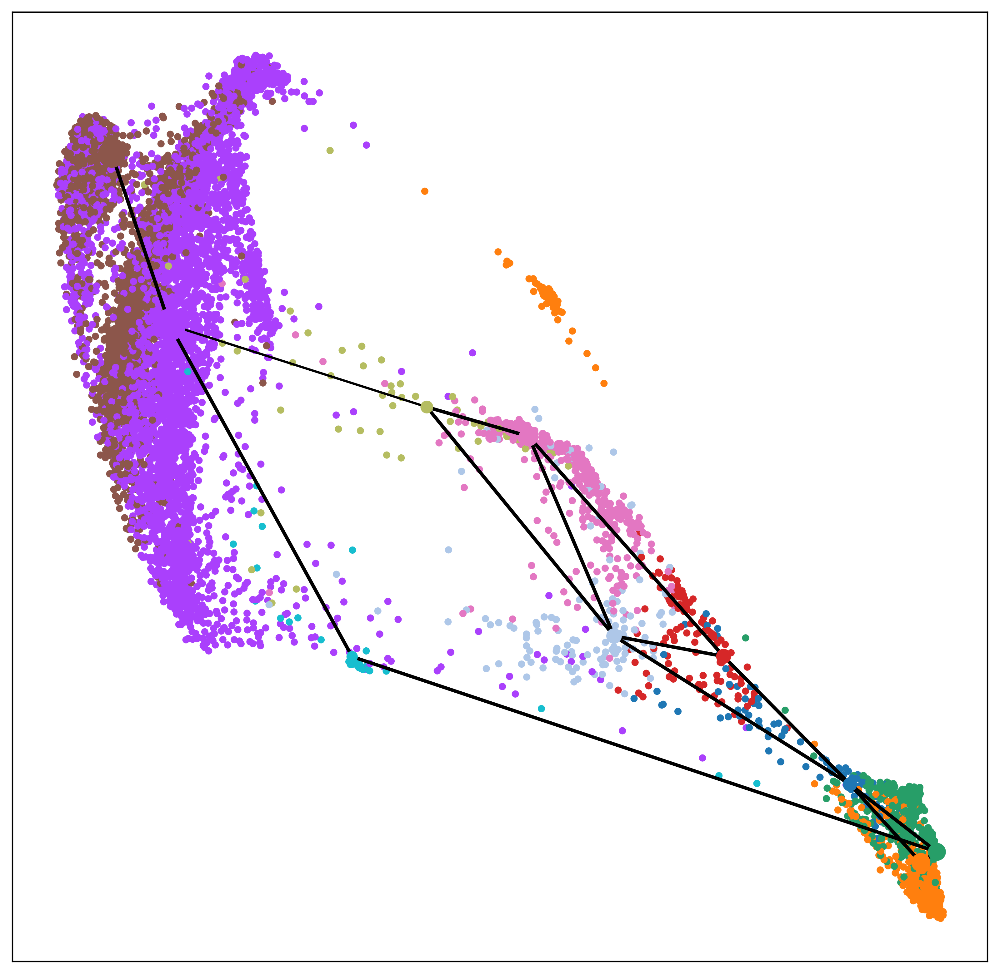

CMP
HSPC_1
HSPC_2
MOP
Macrophage
Microglia
Monocyte
Monocyte_Macrophage
Pre_Macrophage
Promonocyte


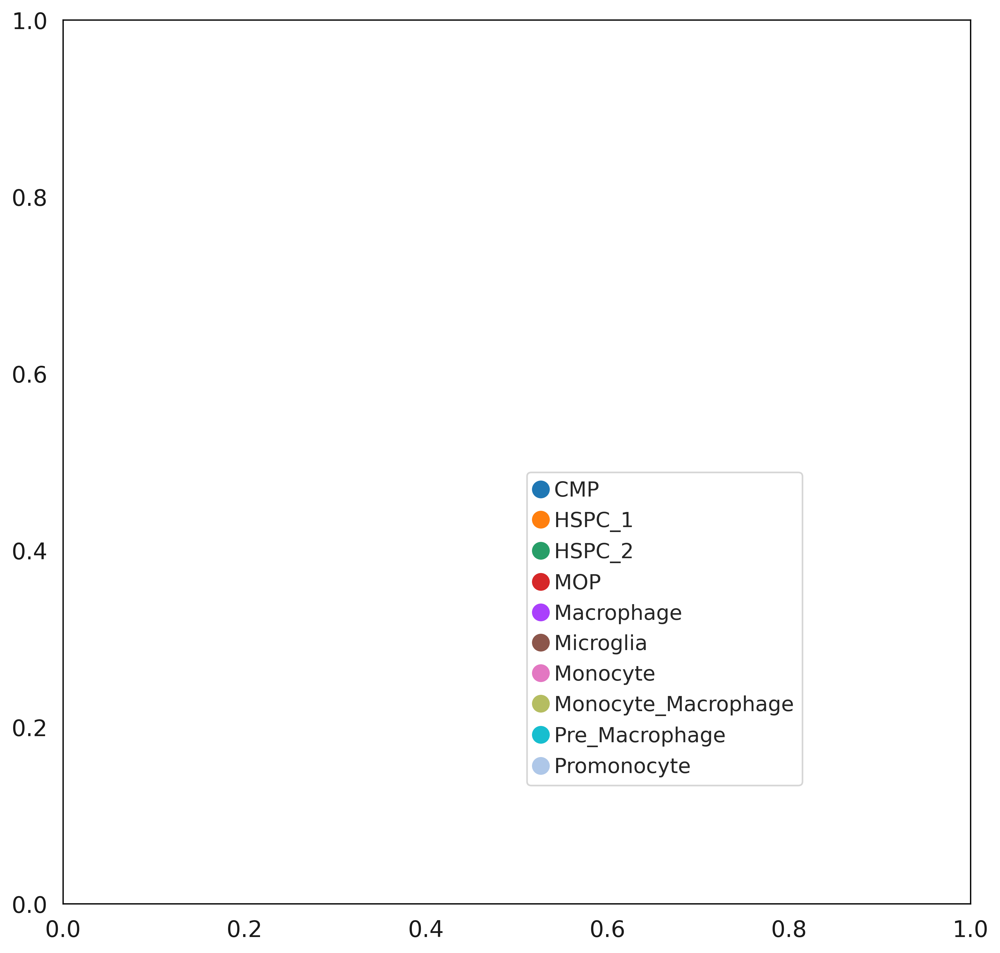

In [45]:
fig, ax = plt.subplots(1,figsize=(10,10))

var = 'cell.labels'

mapper = dict(zip(list(adata.obs[var].cat.categories),list(adata.uns[var+'_colors'])))
adata.obs['col'] = adata.obs[var].astype(str).map(mapper)
ax.scatter(adata.obsm['X_draw_graph_fa'][:,0], adata.obsm['X_draw_graph_fa'][:,1],c=adata.obs['col'],s=10)
sc.pl.paga(adata, threshold=0.3 , title='',edge_width_scale=0.5,max_edge_width=2 ,pos = adata.uns['paga']['pos'],fontsize=0 ,fontoutline=0 ,  text_kwds={'alpha':0},labels = None,fontweight='bold',save = 'HE_paga',node_size_scale=0.5,ax=ax)
# sc.pl.draw_graph(adata,color = var,ax=ax)
# ax.set_zorder(-1)
#Make legends

# box = ax.get_position()
# ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

import matplotlib.lines as mlines
legends = []
for legend in adata.obs[var].cat.categories:
    print(legend)
    legends.append(mlines.Line2D([], [], color=mapper[legend], marker='o', linestyle='None',
                          markersize=10, label=legend))
ax.grid(False)
plt.grid(False)
plt.legend(handles=legends,loc="upper left",bbox_to_anchor=(0.5, 0.5))
plt.savefig("./figures/legends_post_mono_Paga_overlay_v2.pdf")
fig.savefig("./figures/post_mono_Paga_overlay_v2", dpi=300,bbox_inches='tight')

In [52]:
adata_cellxgene = adata[:]
del adata_cellxgene.uns